### Pytesseract

In [1]:
import pytesseract as py
from PIL import Image
img = Image.open("GoToWebinar 004.png")

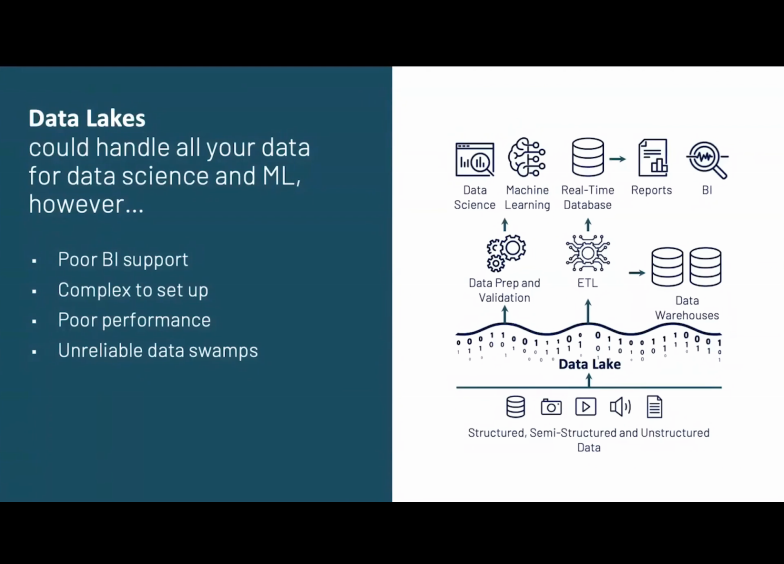

In [2]:
img

In [3]:
text = py.image_to_string(img)
text

'Data Lakes\n\ncould handle all your data\nfor data science and ML,\nhowever...\n\nPoor BI support\nComplex to set up\n\nPoor performance\nUnreliable data swamps\n\n'

In [4]:
import re
text = re.sub('\n'," ",text)
text = re.sub(" +"," ",text)
text

'Data Lakes could handle all your data for data science and ML, however... Poor BI support Complex to set up Poor performance Unreliable data swamps '

### EasyOCR

In [5]:
import easyocr

In [6]:
text = easyocr.Reader(['en'])
text = text.readtext("GoToWebinar 004.png")
text

Neither CUDA nor MPS are available - defaulting to CPU. Note: This module is much faster with a GPU.


[([[26, 106], [150, 106], [150, 132], [26, 132]],
  'Data Lakes',
  0.9954800429811226),
 ([[26, 132], [316, 132], [316, 164], [26, 164]],
  'could handle all your data',
  0.8812521219034384),
 ([[24, 162], [306, 162], [306, 192], [24, 192]],
  'for data science and ML,',
  0.7490636816667912),
 ([[463, 183], [489, 183], [489, 197], [463, 197]],
  'Data',
  0.9957534670829773),
 ([[504, 182], [551, 182], [551, 200], [504, 200]],
  'Machine',
  0.9437400333609858),
 ([[561, 185], [617, 185], [617, 197], [561, 197]],
  'Real-Time',
  0.44176531886259807),
 ([[630, 182], [675, 182], [675, 200], [630, 200]],
  'Reports',
  0.8404629029096465),
 ([[26, 190], [128, 190], [128, 218], [26, 218]],
  'however_',
  0.9998764644262739),
 ([[453, 199], [499, 199], [499, 213], [453, 213]],
  'Science',
  0.9998912758490873),
 ([[511, 199], [553, 199], [553, 213], [511, 213]],
  'earning',
  0.9999845454528696),
 ([[563, 199], [615, 199], [615, 213], [563, 213]],
  'Database',
  0.9933082888374867),

In [7]:
text1 = []
for i in range(len(text)):
    text1.append(text[i][1])

In [8]:
text1

['Data Lakes',
 'could handle all your data',
 'for data science and ML,',
 'Data',
 'Machine',
 'Real-Time',
 'Reports',
 'however_',
 'Science',
 'earning',
 'Database',
 'Poor Bl support',
 'Data Prep and',
 'Complex to set up',
 'Validation',
 'Oata',
 'Poor performance',
 'Warehouses',
 'Unreliable data swamps',
 'Data Lake',
 'Structured, Semi-Structured and Unstructured',
 'Data']

In [9]:
text2 = " "
text2.join(text1)

'Data Lakes could handle all your data for data science and ML, Data Machine Real-Time Reports however_ Science earning Database Poor Bl support Data Prep and Complex to set up Validation Oata Poor performance Warehouses Unreliable data swamps Data Lake Structured, Semi-Structured and Unstructured Data'

### LangChain

In [32]:
from langchain_community.document_loaders.image import UnstructuredImageLoader

In [49]:
loader = UnstructuredImageLoader("pict.jpg")
text = loader.load()
text

This function will be deprecated in a future release and `unstructured` will simply use the DEFAULT_MODEL from `unstructured_inference.model.base` to set default model name


yolox_l0.05.onnx:   0%|          | 0.00/217M [00:00<?, ?B/s]

[Document(page_content='was the best of\n\nIt\n\ntimes, it was the worst\n\nof times, it was the age of wisdom, it was the\n\nage of foolishness...', metadata={'source': 'pict.jpg'})]

In [76]:
l = []
for t in text:
    page_content = t.page_content
    l.append(page_content)

In [77]:
l

['was the best of\n\nIt\n\ntimes, it was the worst\n\nof times, it was the age of wisdom, it was the\n\nage of foolishness...']

In [78]:
text1 = " "
text1 = text1.join(l)

In [79]:
text1

'was the best of\n\nIt\n\ntimes, it was the worst\n\nof times, it was the age of wisdom, it was the\n\nage of foolishness...'

In [80]:
import re
text1 = re.sub('\n'," ",text1)
text1 = re.sub(" +"," ",text1)
text1

'was the best of It times, it was the worst of times, it was the age of wisdom, it was the age of foolishness...'

### cv2

In [84]:
import cv2
import pytesseract

In [86]:
img = cv2.imread("pict.jpg")
text = pytesseract.image_to_string(img)
print(text)

It was the best of
times, it was the worst
of times, it was the age
of wisdom, it was the
age of foolishness...



### Converting PDF to Images

In [87]:
import pypdfium2 as pdfium
import matplotlib.pyplot as plt
from PIL import Image
from io import BytesIO

In [88]:
def convert_pdf_to_images(file_path, scale=300/72):
    
    pdf_file = pdfium.PdfDocument(file_path)  
    page_indices = [i for i in range(len(pdf_file))]
    
    renderer = pdf_file.render(
        pdfium.PdfBitmap.to_pil,
        page_indices = page_indices, 
        scale = scale,
    )
    
    list_final_images = [] 
    
    for i, image in zip(page_indices, renderer):
        
        image_byte_array = BytesIO()
        image.save(image_byte_array, format='jpeg', optimize=True)
        image_byte_array = image_byte_array.getvalue()
        list_final_images.append(dict({i:image_byte_array}))
    
    return list_final_images

In [89]:
def display_images(list_dict_final_images):
    
    all_images = [list(data.values())[0] for data in list_dict_final_images]

    for index, image_bytes in enumerate(all_images):

        image = Image.open(BytesIO(image_bytes))
        figure = plt.figure(figsize = (image.width / 100, image.height / 100))

        plt.title(f"----- Page Number {index+1} -----")
        plt.imshow(image)
        plt.axis("off")
        plt.show()

In [90]:
convert_pdf_to_images = convert_pdf_to_images('C:/Users/Raja/Downloads/LlamaIndex Talk (MistralAI).pdf')

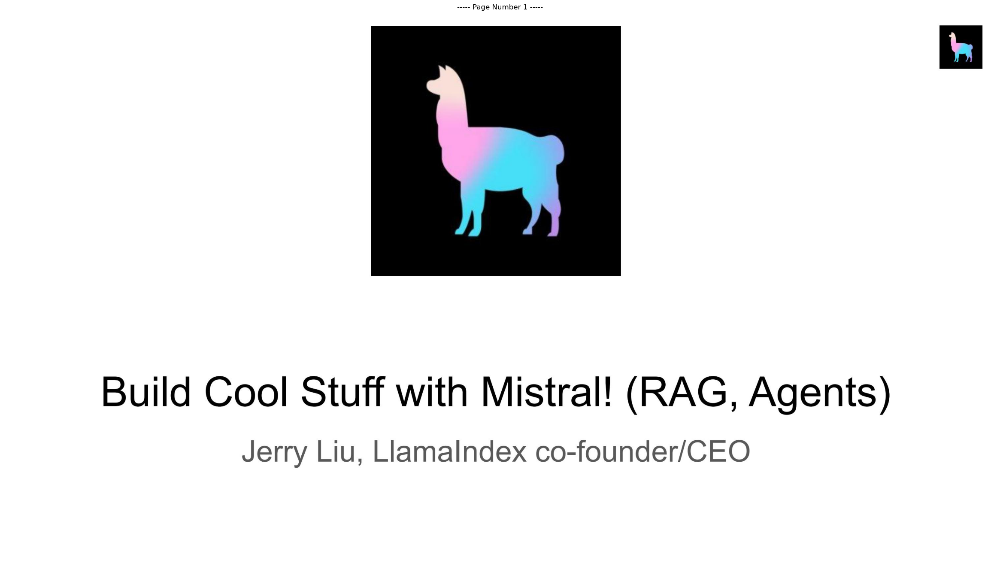

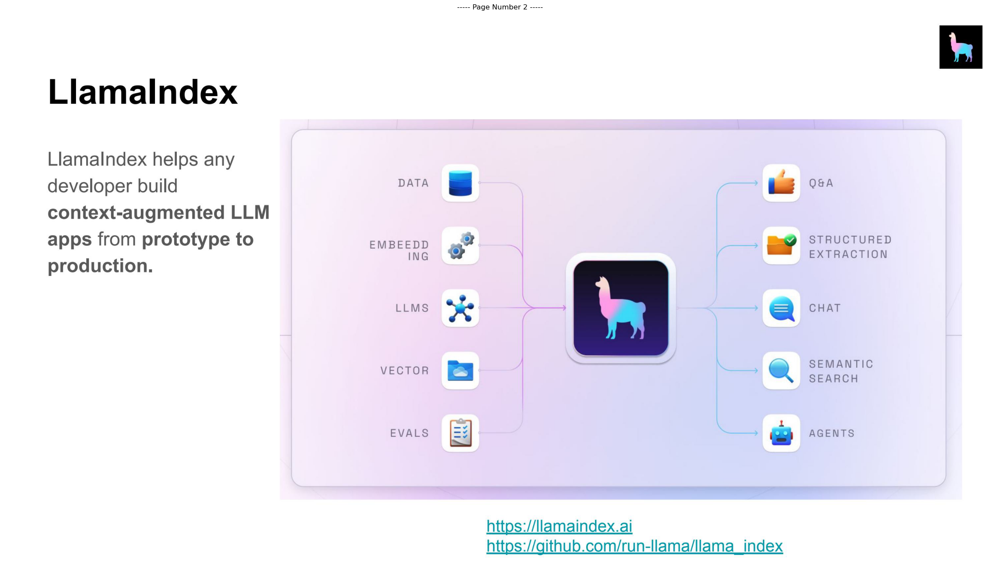

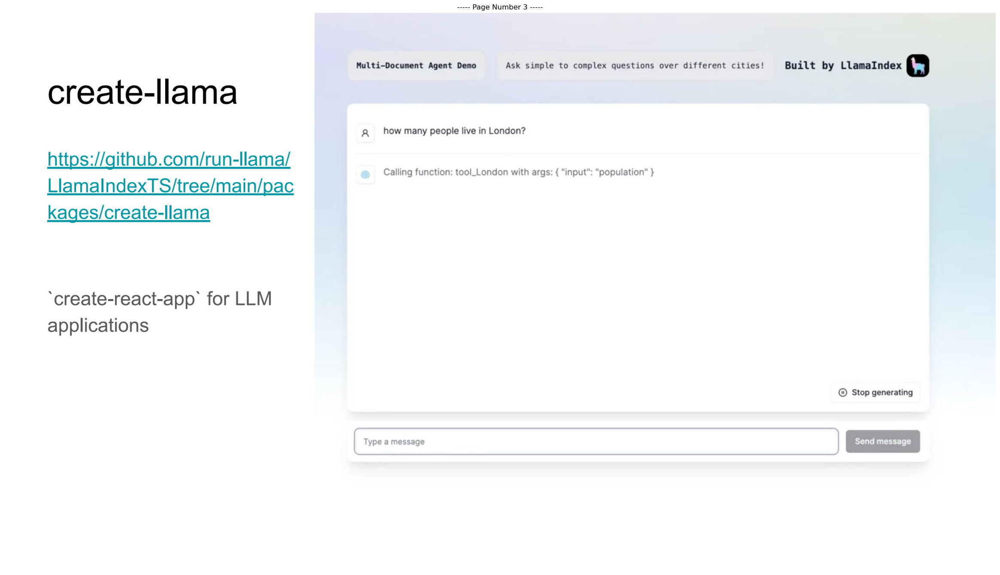

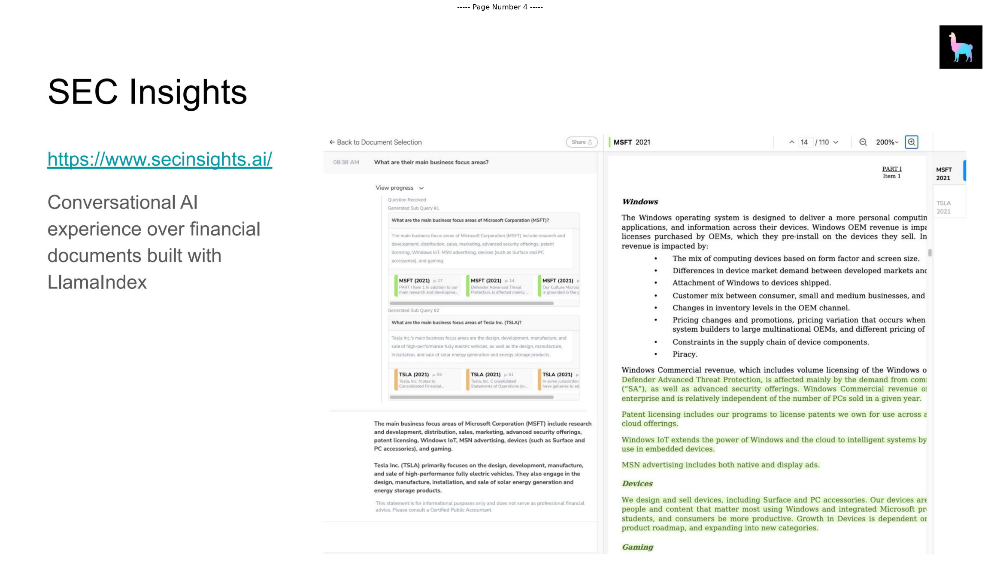

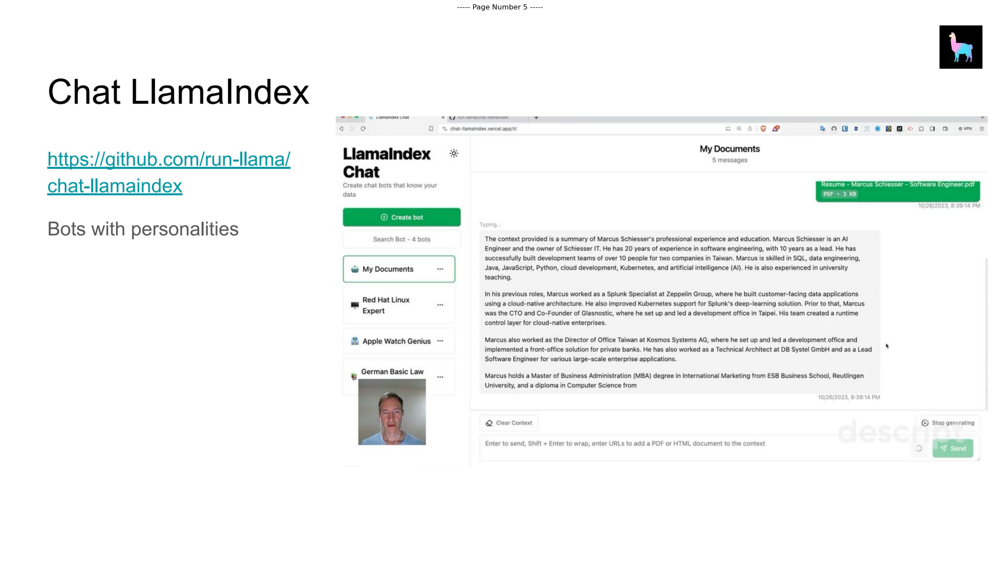

...

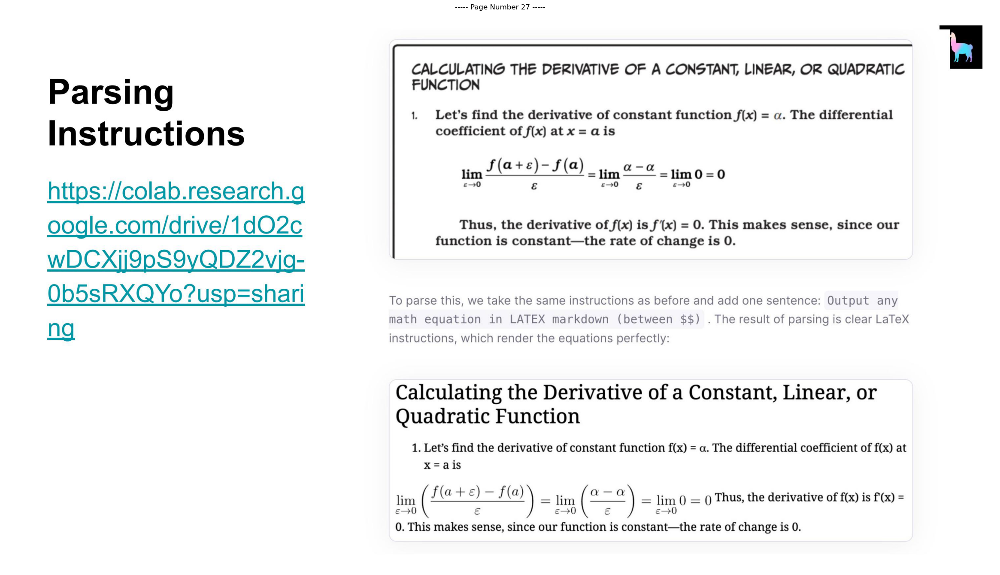

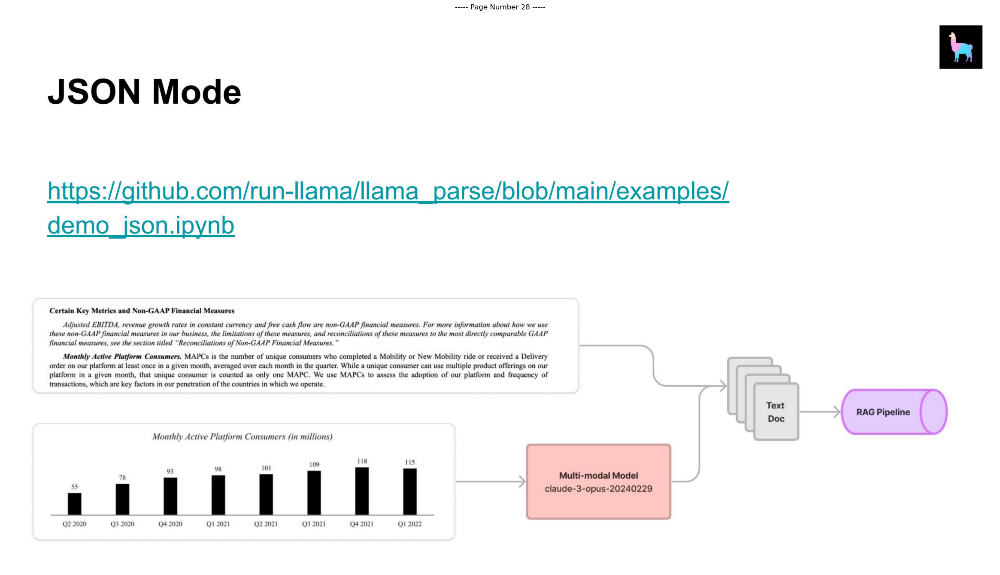

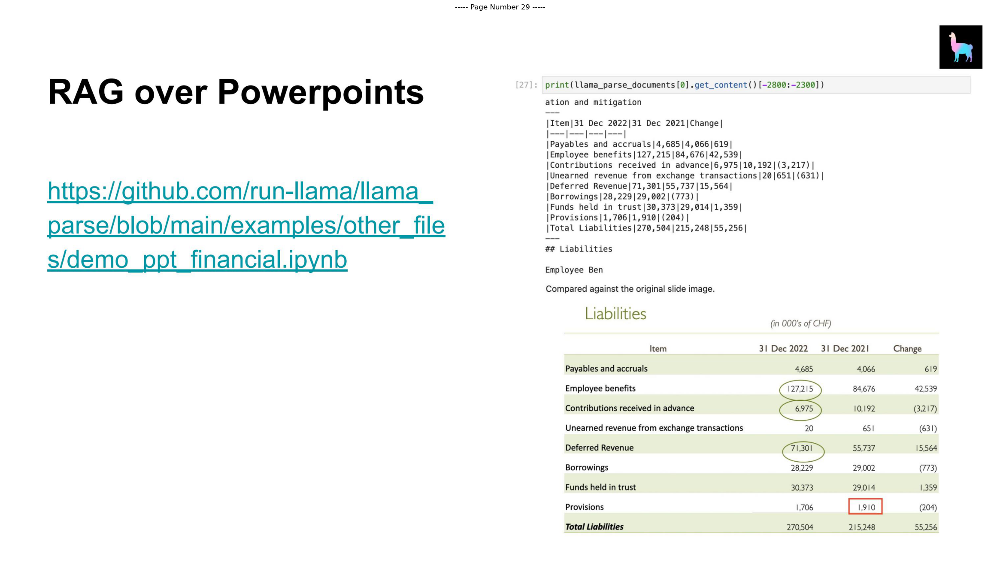

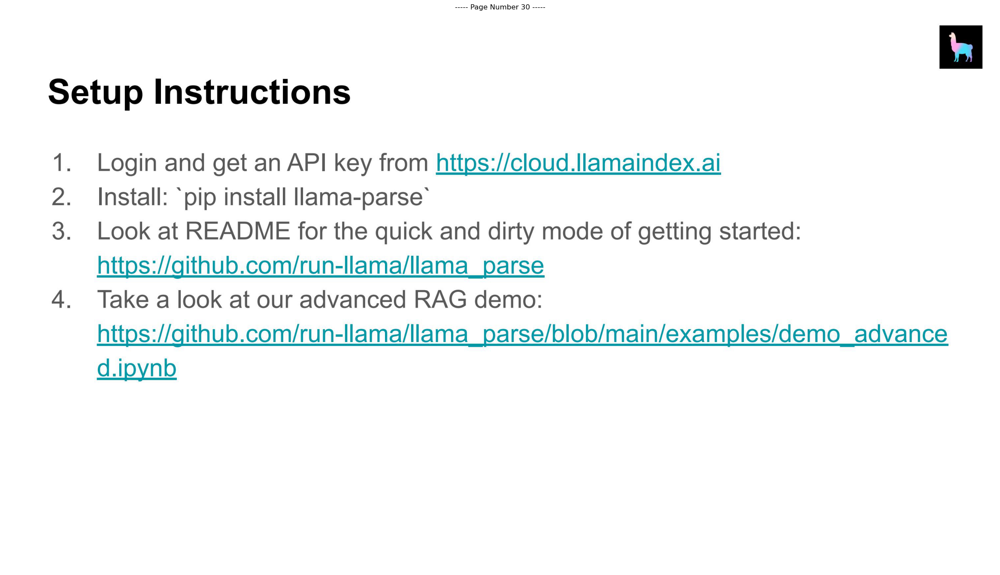

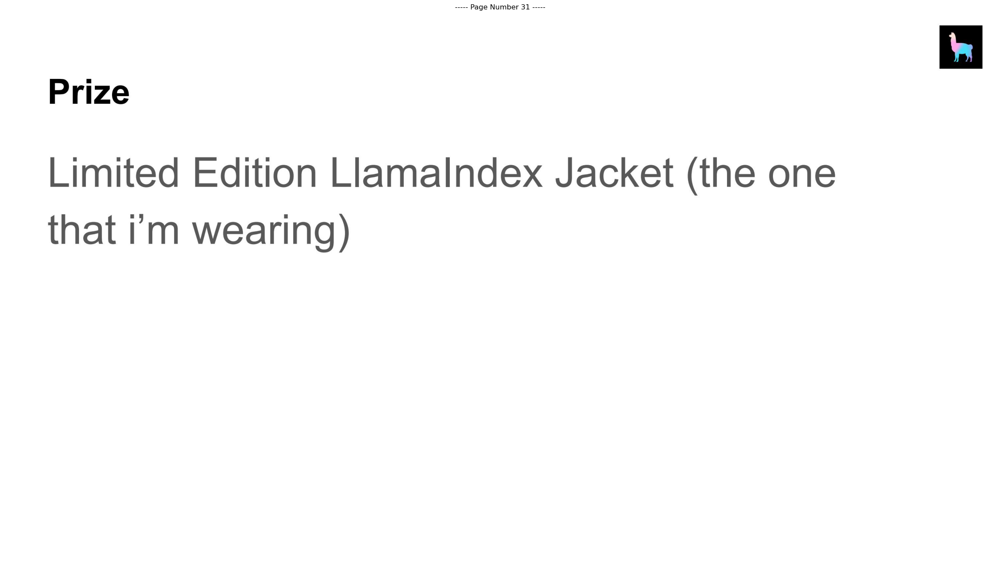

In [91]:
display_images(convert_pdf_to_images)

### Pytesseract

In [95]:
from pytesseract import image_to_string 

In [96]:
def extract_text(list_dict_final_images):
    
    image_list = [list(data.values())[0] for data in list_dict_final_images]
    image_content = []
    
    for index, image_bytes in enumerate(image_list):
        
        image = Image.open(BytesIO(image_bytes))
        raw_text = str(image_to_string(image))
        image_content.append(raw_text)
    
    return "\n".join(image_content)

In [97]:
text = extract_text(convert_pdf_to_images)
text

'Build Cool Stuff with Mistral! (RAG, Agents)\n\nJerry Liu, Llamalndex co-founder/CEO\n\nLlamalndex\n\nLlamalndex helps any\ndeveloper build\ncontext-augmented LLM\napps from prototype to\nproduction.\n\nDATA\n\nEMBEEDD\n\nING\n\nLLMS\n\nVECTOR\n\nEVALS\n\neS @\n\nG\n\nIls\n446\n\nhttps ://llamaindex.ai\nhttos://github.com/run-llama/llama_index\n\nSTRUCTURED\nEXTRACTION\n\nCHAT\n\nSEMANTIC\nSEARCH\n\nAGENTS\n\nMulti-Document Agent Demo Ask simple to complex questions over different cities! Built by LlamaIndex\n\ncreate-llama\n\nhow many people live in London?\n\nhttps://github.com/run-llama/ . . . .\n\n; Calling function: tool_London with args: { "input": “population” }\nLlamalndexTS/tree/main/pac\nkages/create-llama\n\n‘create-react-app’ for LLM\napplications\n\n@ Stop generating\n\n[ Type a message ] Send message\n\n\nSEC Insights\n\nhttps://www.secinsights.ai/\n\nConversational Al\nexperience over financial\ndocuments built with\nLlamalndex\n\n€ Back to Document Selection\n\n38 AM W

### EasyOCR

In [98]:
from easyocr import Reader
language_reader = Reader(["en"])

Neither CUDA nor MPS are available - defaulting to CPU. Note: This module is much faster with a GPU.


In [99]:
def extract_text(list_dict_final_images):
    
    image_list = [list(data.values())[0] for data in list_dict_final_images]
    image_content = []
    
    for index, image_bytes in enumerate(image_list):
        
        image = Image.open(BytesIO(image_bytes))
        raw_text = language_reader.readtext(image)
        raw_text = "\n".join([res[1] for res in raw_text])
                       
        image_content.append(raw_text)
    
    return "\n".join(image_content)

In [100]:
text1 = extract_text(convert_pdf_to_images)
text1

'Build Cool Stuff with Mistrall (RAG, Agents)\nJerry Liu, Llamalndex co-founderICEO\nLlamalndex\nLlamalndex helps any\ndeveloper build\nDATA\nQ&A\ncontext-augmented LLM\napps from prototype to\nEMBEEDD\nSTRUCTURED\nING\nEXTRACTION\nproduction:\nLLMS\nCHAT\nSEMANTIC\nVECTOR\nSEARCH\nEVALS\n39\nAGENTS\nhttps IIllamaindexai\nhttps IIgithub com/run-Ilamalllama_index\nMulti-Document Agent Demo\nAsk Simple to complex questions\nover different cities!\nBuilt by LlamaIndex\ncreate-Ilama\n8\nhow many people live in London?\nhttps IIgithub comlrun-llamal\nCalling function: tool_London with args: { "input": "population" }\nLlamalndexTSItreelmainlpac\nkaqeslcreate-Ilama\n\'create-react-app\nfor LLM\napplications\nStop generating\nType a message\nSend message\nSEC Insights\nBack to Document Selection\nShare\nMSFT 2021\n14\n\'110\n0\n200%~\nhttps IIwww secinsightsaiL\n08.38 AM\nWhat are their main business focus areas?\nPART I\nMSFT\nItem\n2021\nprogress\nConversational AI\nQueston Recerycd\nWindows

### PyPDF

In [101]:
from PyPDF2 import PdfReader

In [102]:
def extract_text(PDF_File):

    pdf_reader = PdfReader(PDF_File)
    
    raw_text = ''

    for i, page in enumerate(pdf_reader.pages):
        
        text = page.extract_text()
        if text:
            raw_text += text

    return raw_text

In [104]:
text2 = extract_text("C:/Users/Raja/Downloads/LlamaIndex Talk (MistralAI).pdf")
text2

'Build Cool Stuff with Mistral! (RAG, Agents) \nJerry Liu, LlamaIndex co-founder/CEO \nLlamaIndex \nhttps:// llamaindex.ai \nhttps://github.com/run-llama/llama_index \nLlamaIndex helps any \ndeveloper build \ncontext-augmented LLM \napps from prototype to \nproduction. create-llama \nhttps://github.com/run-llama/\nLlamaIndexTS/tree/main/pac\nkages/create-llama \n`create-react-app` for LLM \napplications SEC Insights \nhttps://www.secinsights.ai/  \nConversational AI \nexperience over financial \ndocuments built with \nLlamaIndex \nChat LlamaIndex \nhttps://github.com/run-llama/\nchat-llamaindex \nBots with personalities Llama Packs \nhttps://llamahub.ai/?tab=llam\na_packs \n50+ prepackaged templates \nused to kickstart your app. \nAgents and Agent \nTools \nLlamaHub: \nhttps://llamahub.ai/?tab=tools \nNotebooks: \nhttps://github.com/run-llama/ll\nama-hub/tree/main/llama_hub\n/tools/notebooks \n30+ predefined tools to help \nkickstart your agent \nLocal RAG CLI \nLlamaPack: \nhttps://ll

### LangChain

In [110]:
from langchain.document_loaders import UnstructuredFileLoader

def extract_text(pdf_file):
    
    loader = UnstructuredFileLoader(pdf_file)
    documents = loader.load()
    pdf_pages_content = '\n'.join(doc.page_content for doc in documents)
    
    return pdf_pages_content

In [ ]:
text3 = extract_text("C:/Users/Raja/Downloads/LlamaIndex Talk (MistralAI).pdf")
text3